# Annotations using clustering for cells for bone_marrow_s1

In [1]:
slide_id = "bone_marrow_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_bone_marrow_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 36523, 13762), (3, 18262, 6881)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (84518, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (84518, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (84518, 477)
      └── 'table_nuclei': AnnData (84518, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 84518 × 477
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,21,0,0,0,0,21,152.537818,25.739063,cell_labels
1,aaaaaaab-1,20,0,0,0,0,20,136.687974,24.384376,cell_labels
2,aaaaaaac-1,12,0,0,0,0,12,34.409064,11.018125,cell_labels
3,aaaaaaad-1,5,0,0,0,0,5,65.928127,14.450001,cell_labels
4,aaaaaaae-1,35,0,0,0,0,35,101.195160,32.693126,cell_labels
...,...,...,...,...,...,...,...,...,...,...
84513,aaabekcb-1,30,0,0,0,0,30,97.221410,16.482032,cell_labels
84514,aaabekcc-1,9,0,0,0,0,9,388.795327,4.244688,cell_labels
84515,aaabekcd-1,41,0,0,0,0,41,196.610320,31.970626,cell_labels
84516,aaabekce-1,19,0,0,0,0,19,265.292978,17.972188,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACAN,ENSG00000157766,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
...,...,...,...
VPREB3,ENSG00000128218,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 20792 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs11_leiden_res0.2', 'pca_n10_pcs11_leiden_res0.4', 'pca_n10_pcs11_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs11', 'pca_n10_pcs11_leiden_res0.2', 'pca_n10_pcs11_leiden_res0.2_colors', 'pca_n10_pcs11_leiden_res0.4', 'pca_n10_pcs11_leiden_res0.4_colors', 'pca_n10_pcs11_leiden_res0.6', 'pca_n10_pcs11_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs11_leiden_res0.2', 'rank_genes_pca_n10_pcs11_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs11_connectivities', 'pca_n10_pcs11_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs11_leiden_res0.2,pca_n10_pcs11_leiden_res0.4,pca_n10_pcs11_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,23.910722,Naive CD8 T cell,14,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,22.804023,Early SOX4+ erythroblast,19,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,28.584145,CD14+MHCIIhigh monocyte,22,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,25.129637,S100A+ preNeutrophil (cycling),24,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,24.113518,Naive CD8 T cell,37,1,0,5,5,Erythroid_cell,Erythroid_cell,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabekbo-1,nucleus_boundaries,morpho,aaabekbo-1,35.966385,S100A+ preNeutrophil (cycling),60,0,3,3,3,Neutrophil,Neutrophil,normal_cell
aaabekbp-1,nucleus_boundaries,morpho,aaabekbp-1,16.189590,CMP,13,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaabekcd-1,nucleus_boundaries,morpho,aaabekcd-1,29.959769,Naive CD8 T cell,34,2,3,3,3,Neutrophil,Neutrophil,normal_cell
aaabekce-1,nucleus_boundaries,morpho,aaabekce-1,16.595272,CD14+MHCIIhigh monocyte,21,0,1,2,2,Unknown,Unknown,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.017701,0.324894
ACAN,0.221028,1.135919
ACE2,0.065413,0.626345
ACKR1,0.254766,1.218292
ACTA2,0.107686,0.803911
...,...,...
VPREB3,0.085565,0.718073
VSIG4,0.209878,1.119279
VWA5A,0.173503,1.015228
VWF,0.301438,1.322194


## 2. Preprocessing

<Axes: >

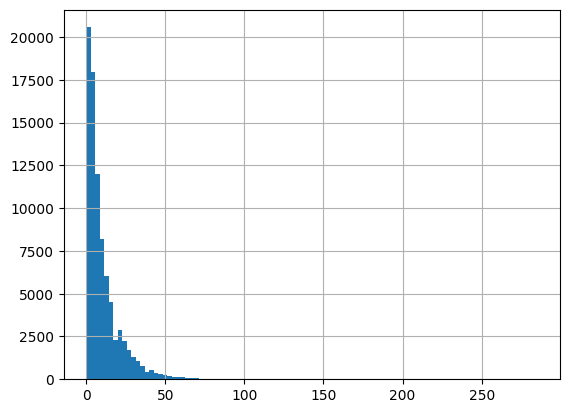

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

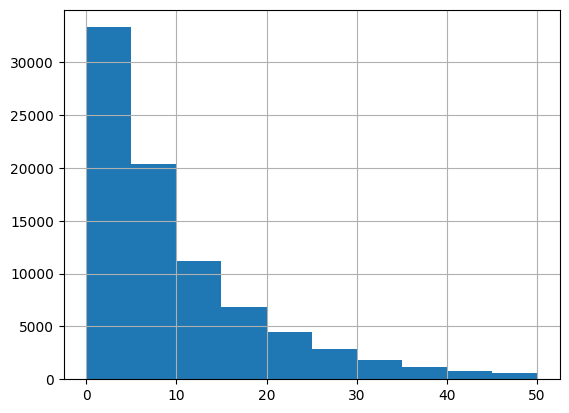

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 71664
Percentage of cells with less than 20 transcripts: 84.79%
-----
Number of cells with less than 15 transcripts: 64822
Percentage of cells with less than 15 transcripts: 76.7%
-----
Number of cells with less than 10 transcripts: 53618
Percentage of cells with less than 10 transcripts: 63.44%
-----
Number total of cells: 84518


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

28203


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


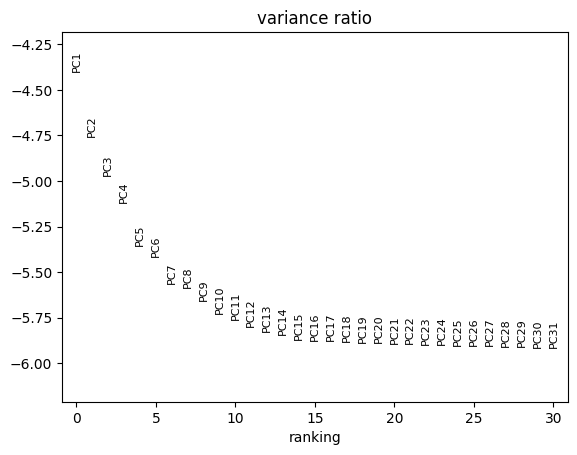

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 28203 × 477
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4803/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


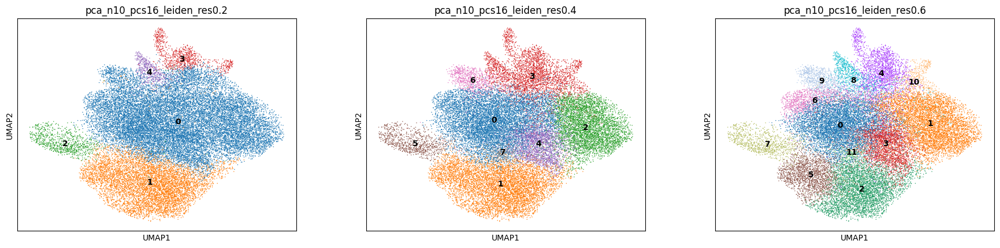

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['2', '5', '3', '1', '0', ..., '4', '11', '10', '9', '7']
Length: 12
Categories (12, object): ['0', '1', '2', '3', ..., '8', '9', '10', '11']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'

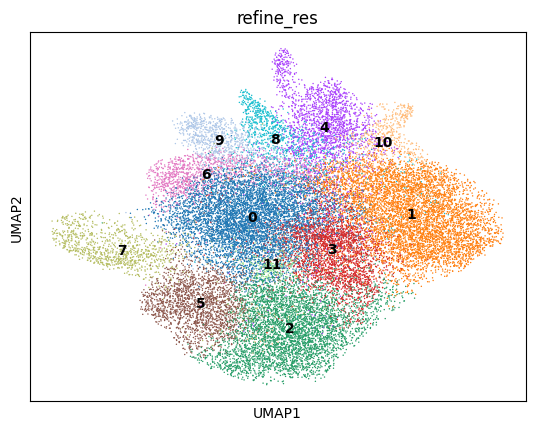

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

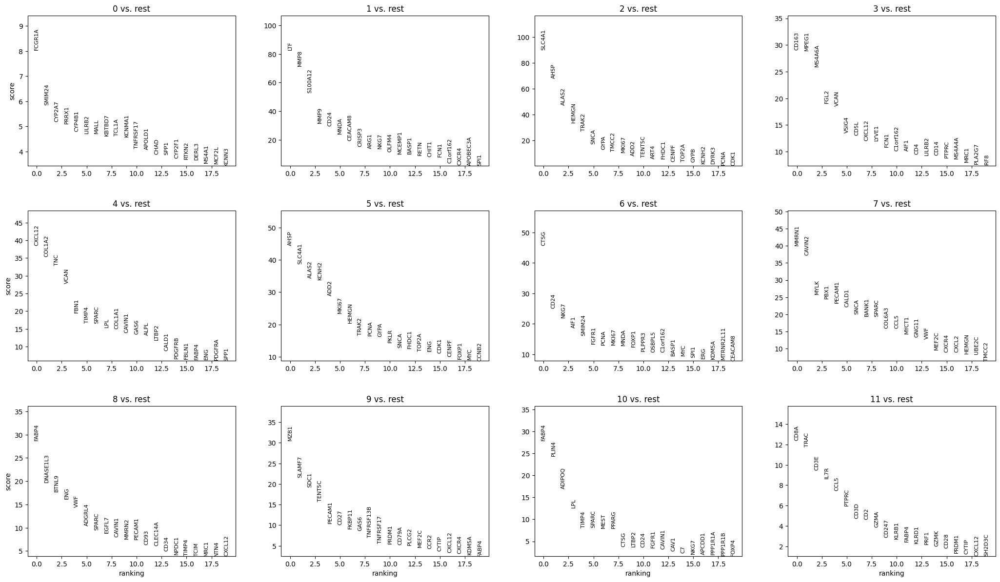

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,24.8
1,NA,NA,NA,22.7
2,Neutrophil,Neutrophil,normal_cell,21.6
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,10.9
4,Plasma,Plasma,normal_cell,7.9


In [33]:
top_ranked_genes[cluster_id]

0    FCGR1A
1    SMIM24
2    CYP2A7
3     PRRX1
4    CYP4B1
5    LILRB2
6      MALL
Name: 0, dtype: object

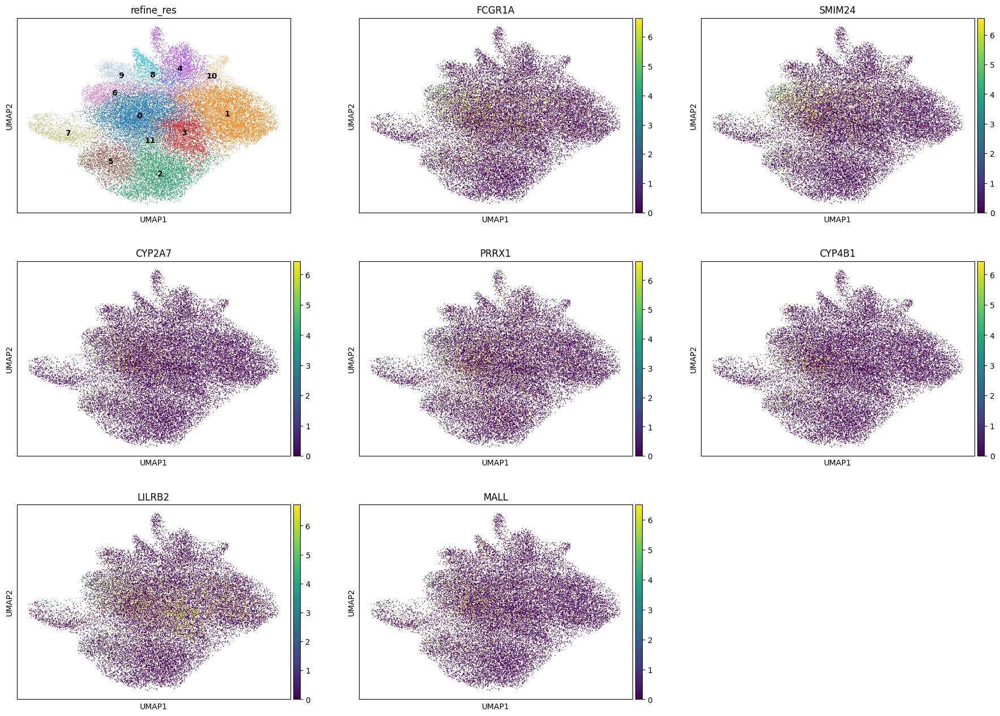

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 6157
Percentage of cells in cluster 0: 21.8


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Neutrophil,Neutrophil,normal_cell,48.7
1,NA,NA,NA,42.4
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.1
3,Unknown,Unknown,normal_cell,2.8
4,Erythroid_cell,Erythroid_cell,normal_cell,1.4


In [39]:
top_ranked_genes[cluster_id]

0        LTF
1       MMP8
2    S100A12
3       MMP9
4       CD24
5       MNDA
6    CEACAM8
Name: 1, dtype: object

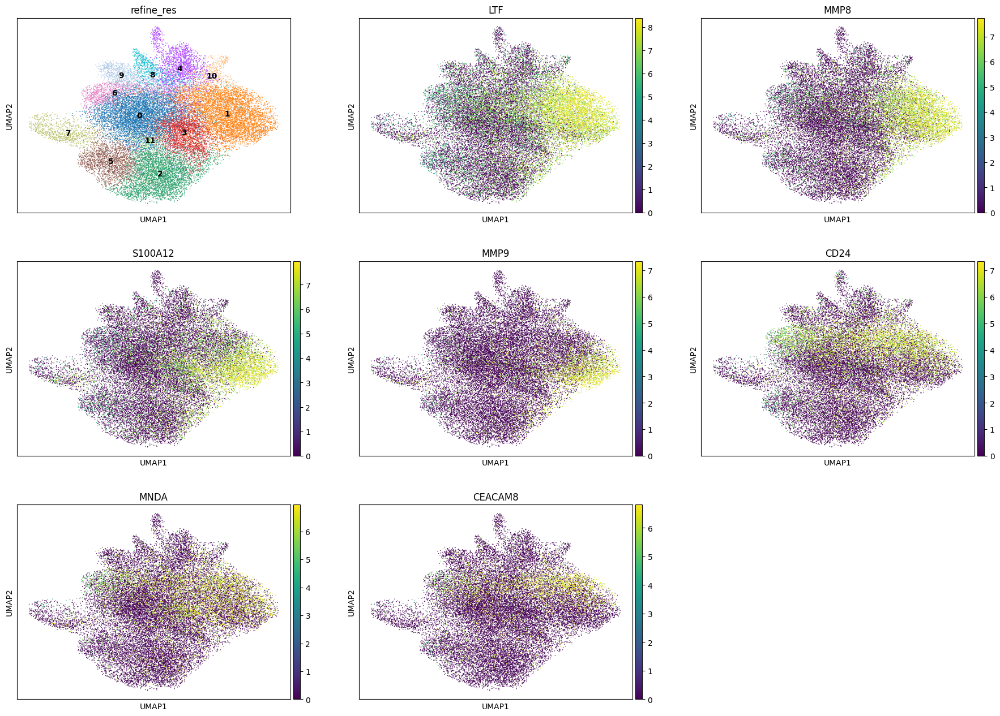

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 5635
Percentage of cells in cluster 1: 20.0


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Neutrophil'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Neutrophil'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,46.9
1,Erythroid_cell,Erythroid_cell,normal_cell,46.2
2,Neutrophil,Neutrophil,normal_cell,2.3
3,Unknown,Unknown,normal_cell,1.9
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.3


In [45]:
top_ranked_genes[cluster_id]

0    SLC4A1
1      AHSP
2     ALAS2
3     HEMGN
4     TRAK2
5      SNCA
6      GYPA
Name: 2, dtype: object

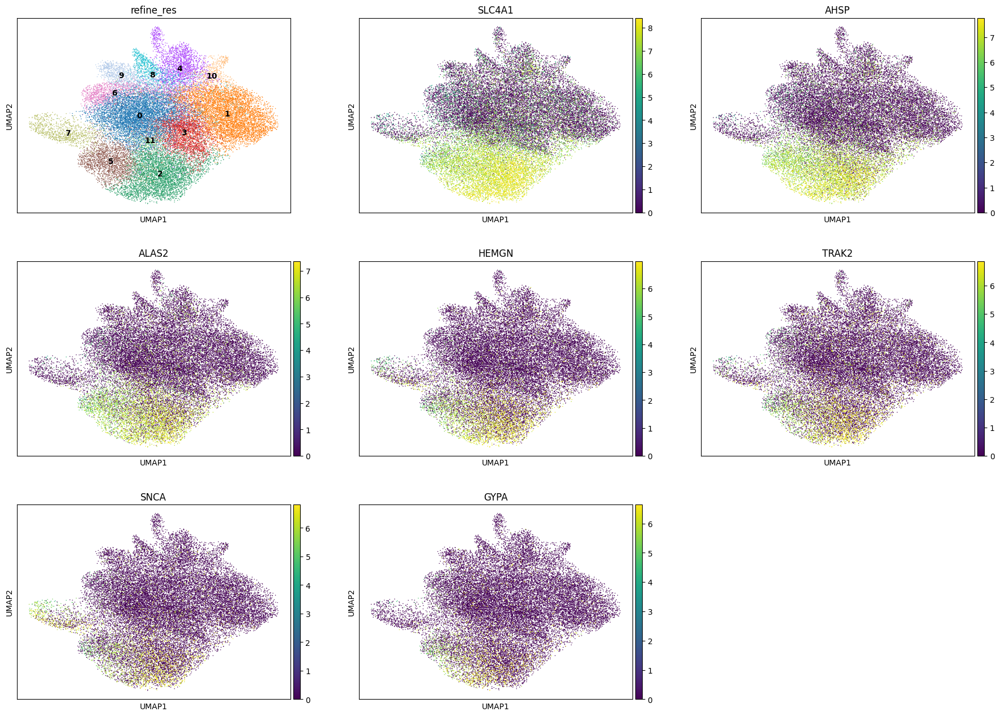

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 4372
Percentage of cells in cluster 2: 15.5


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Erythroid_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Erythroid_cell'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,51.6
1,NA,NA,NA,32.3
2,Neutrophil,Neutrophil,normal_cell,6.0
3,Unknown,Unknown,normal_cell,3.7
4,Erythroid_cell,Erythroid_cell,normal_cell,3.0


In [51]:
top_ranked_genes[cluster_id]

0     CD163
1     MPEG1
2    MS4A6A
3      FGL2
4      VCAN
5     VSIG4
6      CD5L
Name: 3, dtype: object

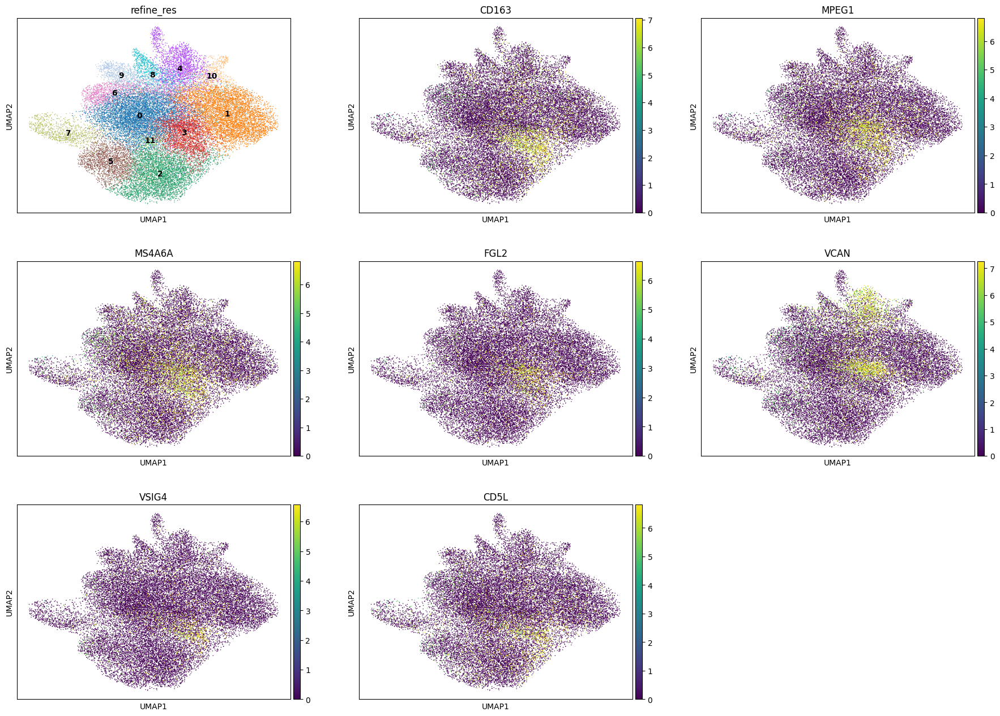

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 2812
Percentage of cells in cluster 3: 10.0


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,48.8
1,Fibroblast,Fibroblast,normal_cell,28.7
2,Neutrophil,Neutrophil,normal_cell,6.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.2
4,Unknown,Unknown,normal_cell,4.5


In [57]:
top_ranked_genes[cluster_id]

0    CXCL12
1    COL1A2
2       TNC
3      VCAN
4      FBN1
5     TIMP4
6     SPARC
Name: 4, dtype: object

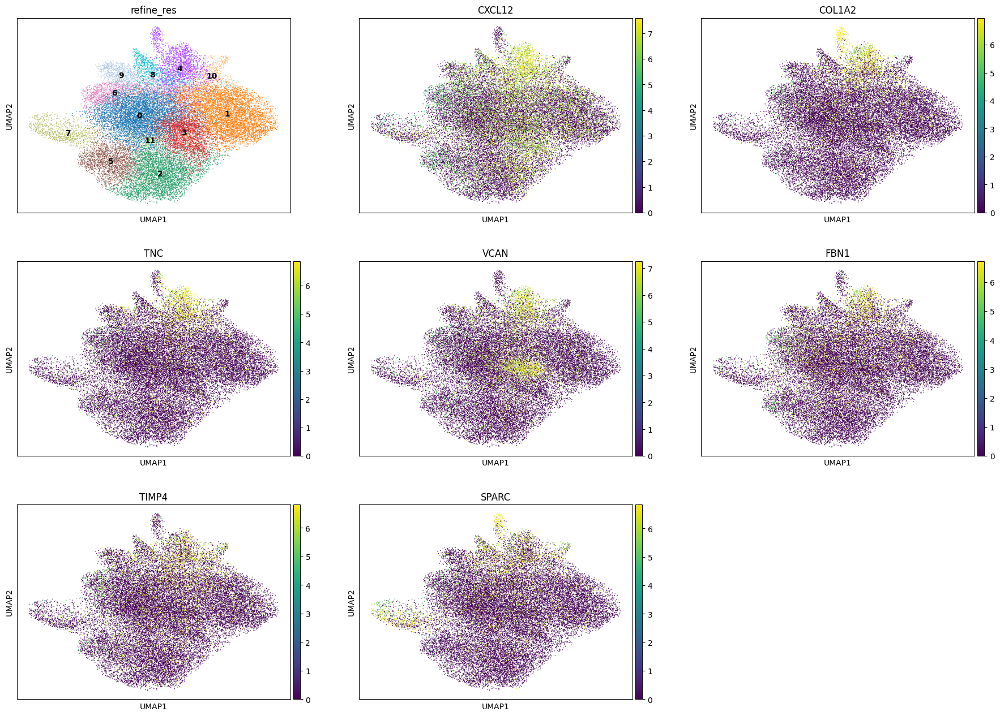

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 2102
Percentage of cells in cluster 4: 7.5


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Erythroid_cell,Erythroid_cell,normal_cell,82.9
1,Neutrophil,Neutrophil,normal_cell,5.0
2,NA,NA,NA,4.7
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.6
4,Unknown,Unknown,normal_cell,1.9


In [63]:
top_ranked_genes[cluster_id]

0      AHSP
1    SLC4A1
2     ALAS2
3     KCNH2
4      ADD2
5     MKI67
6     HEMGN
Name: 5, dtype: object

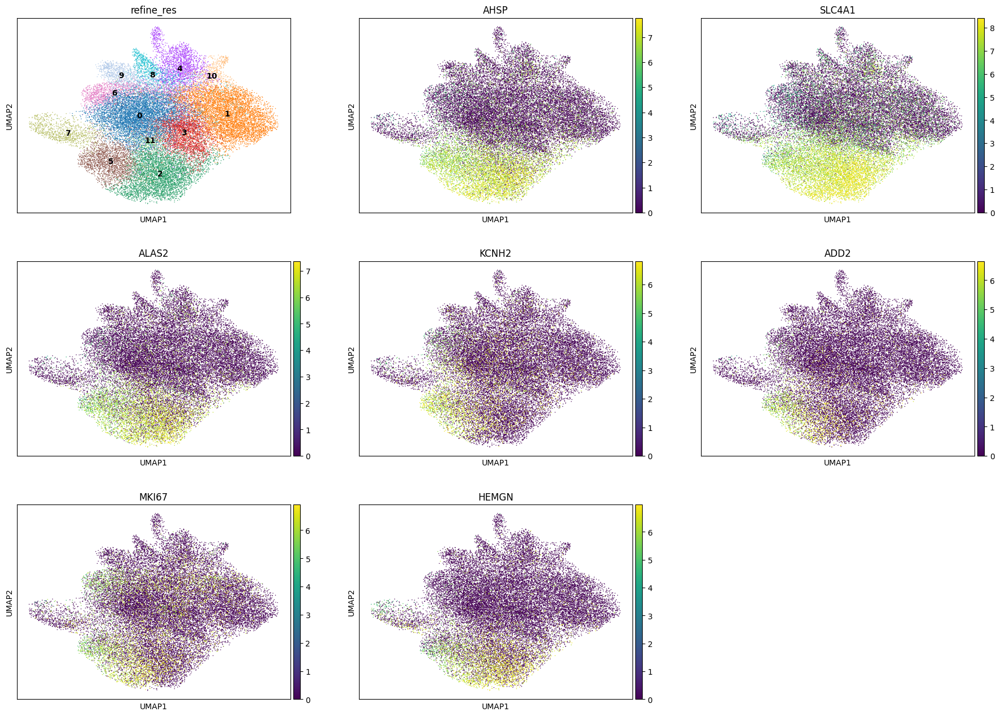

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 2005
Percentage of cells in cluster 5: 7.1


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Erythroid_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Erythroid_cell'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Neutrophil,Neutrophil,normal_cell,76.5
1,NA,NA,NA,9.4
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.2
3,Unknown,Unknown,normal_cell,3.5
4,Erythroid_cell,Erythroid_cell,normal_cell,1.7


In [69]:
top_ranked_genes[cluster_id]

0      CTSG
1      CD24
2      NKG7
3      AIF1
4    SMIM24
5     FGFR1
6      PCNA
Name: 6, dtype: object

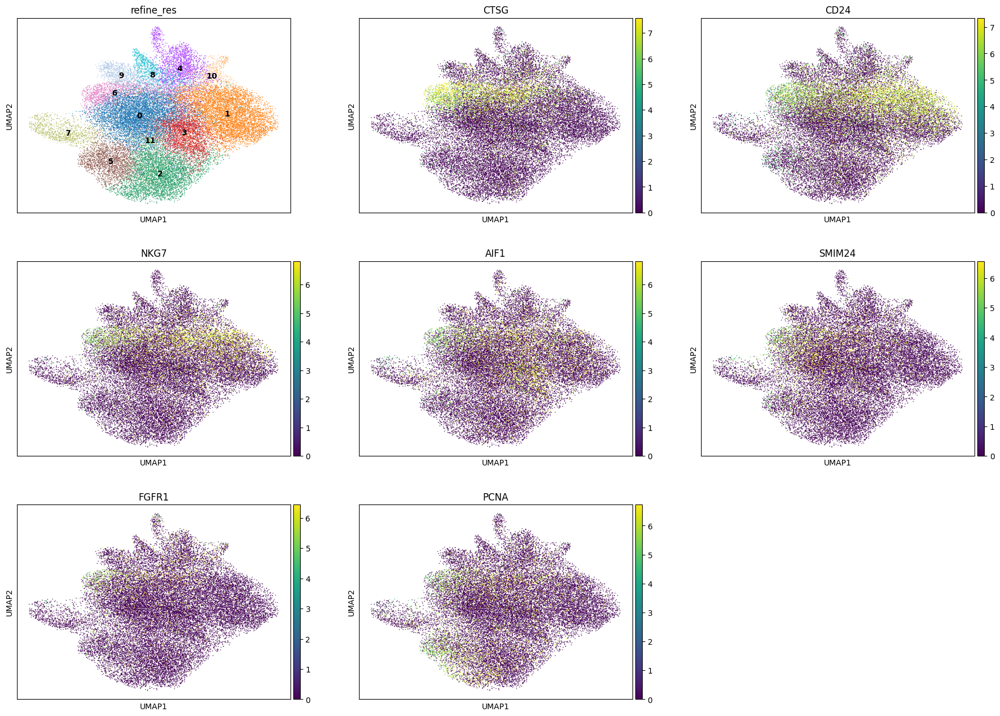

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 1282
Percentage of cells in cluster 6: 4.5


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Neutrophil'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Neutrophil'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,42.3
1,Endothelial,Endothelial,normal_cell,33.0
2,Erythroid_cell,Erythroid_cell,normal_cell,7.2
3,Neutrophil,Neutrophil,normal_cell,6.7
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,4.8


In [75]:
top_ranked_genes[cluster_id]

0     MMRN1
1    CAVIN2
2      MYLK
3      PBX1
4    PECAM1
5     CALD1
6      SNCA
Name: 7, dtype: object

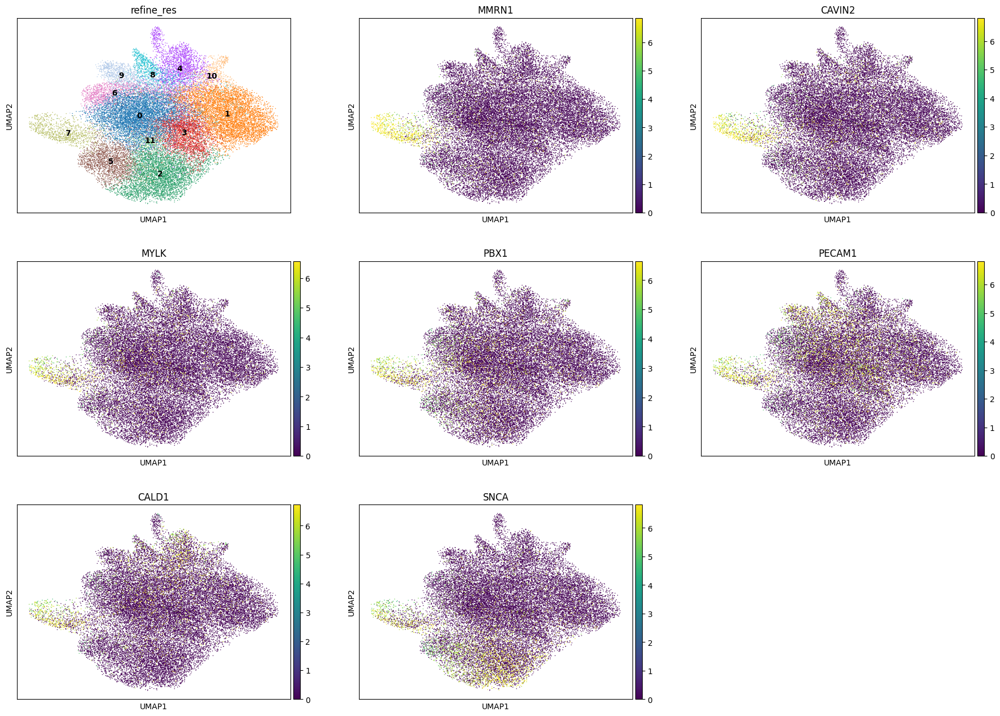

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1061
Percentage of cells in cluster 7: 3.8


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.9. Cluster 8

In [5]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,46.5
1,Mesenchymal_stromal_cell,MSC,normal_cell,33.7
2,Neutrophil,Neutrophil,normal_cell,5.1
3,Unknown,Unknown,normal_cell,4.1
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,4.0


In [81]:
top_ranked_genes[cluster_id]

0       FABP4
1    DNASE1L3
2       BTNL9
3         ENG
4         VWF
5      ADGRL4
6       SPARC
Name: 8, dtype: object

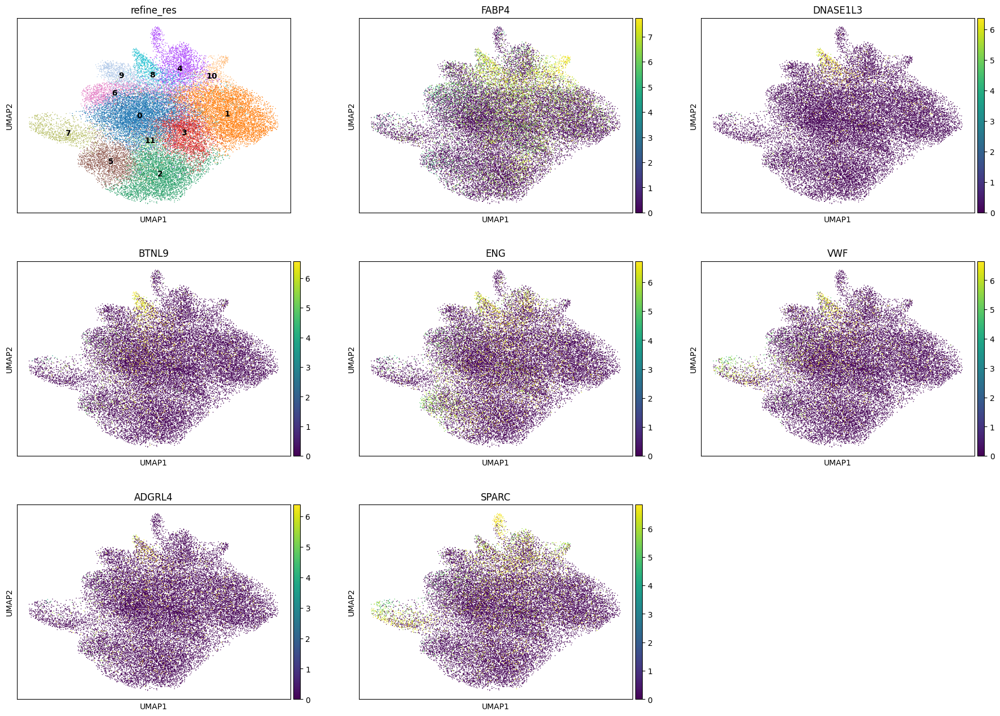

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 987
Percentage of cells in cluster 8: 3.5


In [6]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mesenchymal_stromal_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'MSC'

### 5.10. Cluster 9

In [85]:
cluster_id = '9'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,48.5
1,NA,NA,NA,24.9
2,Neutrophil,Neutrophil,normal_cell,8.1
3,Unknown,Unknown,normal_cell,6.9
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,5.2


In [87]:
top_ranked_genes[cluster_id]

0      MZB1
1    SLAMF7
2      SDC1
3    TENT5C
4    PECAM1
5      CD27
6    FKBP11
Name: 9, dtype: object

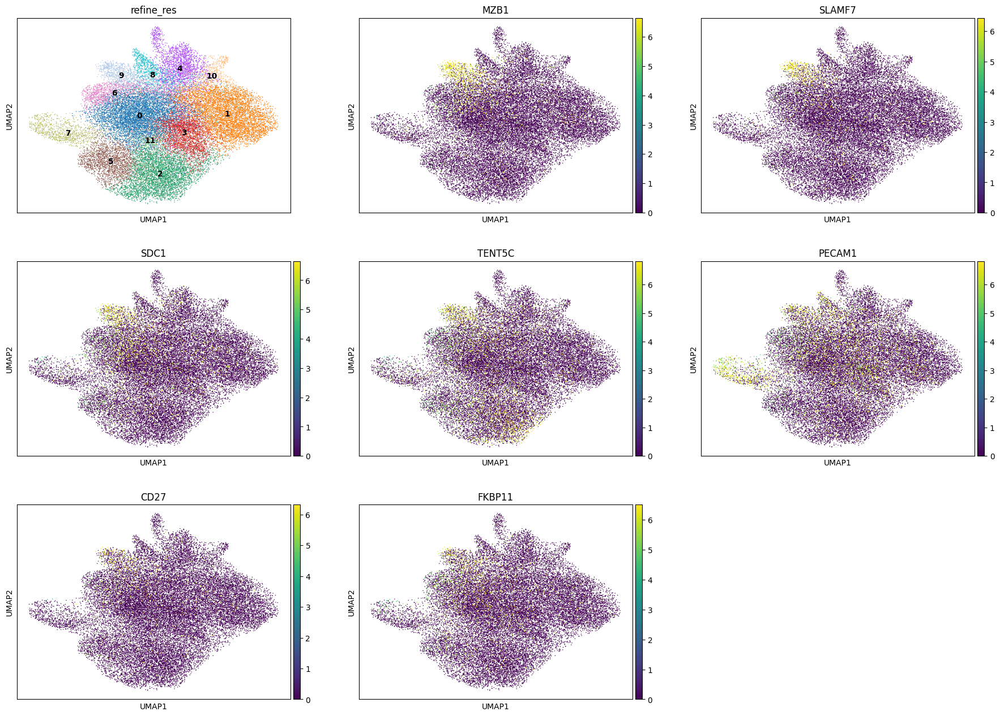

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 916
Percentage of cells in cluster 9: 3.2


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.11. Cluster 10

In [91]:
cluster_id = '10'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,48.5
1,Neutrophil,Neutrophil,normal_cell,18.0
2,Fibroblast,Fibroblast,normal_cell,14.5
3,Unknown,Unknown,normal_cell,6.7
4,Mesenchymal_stromal_cell,MSC,normal_cell,4.0


In [93]:
top_ranked_genes[cluster_id]

0     FABP4
1     PLIN4
2    ADIPOQ
3       LPL
4     TIMP4
5     SPARC
6      MEST
Name: 10, dtype: object

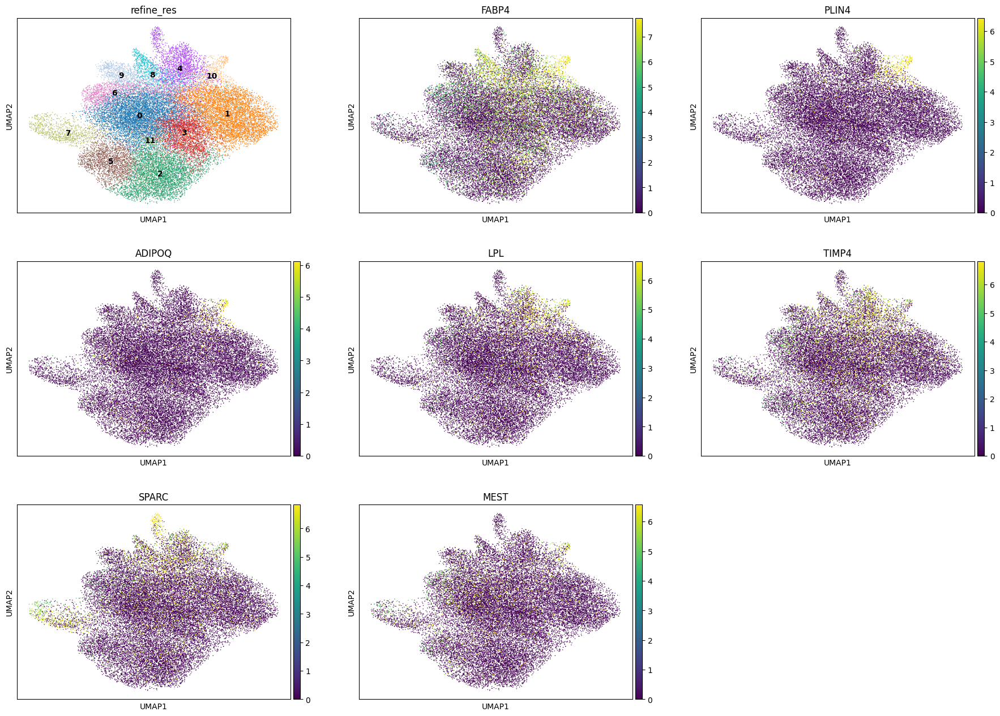

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 571
Percentage of cells in cluster 10: 2.0


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mesenchymal_stromal_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'MSC'

### 5.12. Cluster 11

In [97]:
cluster_id = '11'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,43.2
1,Unknown,Unknown,normal_cell,20.5
2,Neutrophil,Neutrophil,normal_cell,10.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,9.6
4,Plasma,Plasma,normal_cell,7.3


In [99]:
top_ranked_genes[cluster_id]

0     CD8A
1     TRAC
2     CD3E
3     IL7R
4     CCL5
5    PTPRC
6     CD3D
Name: 11, dtype: object

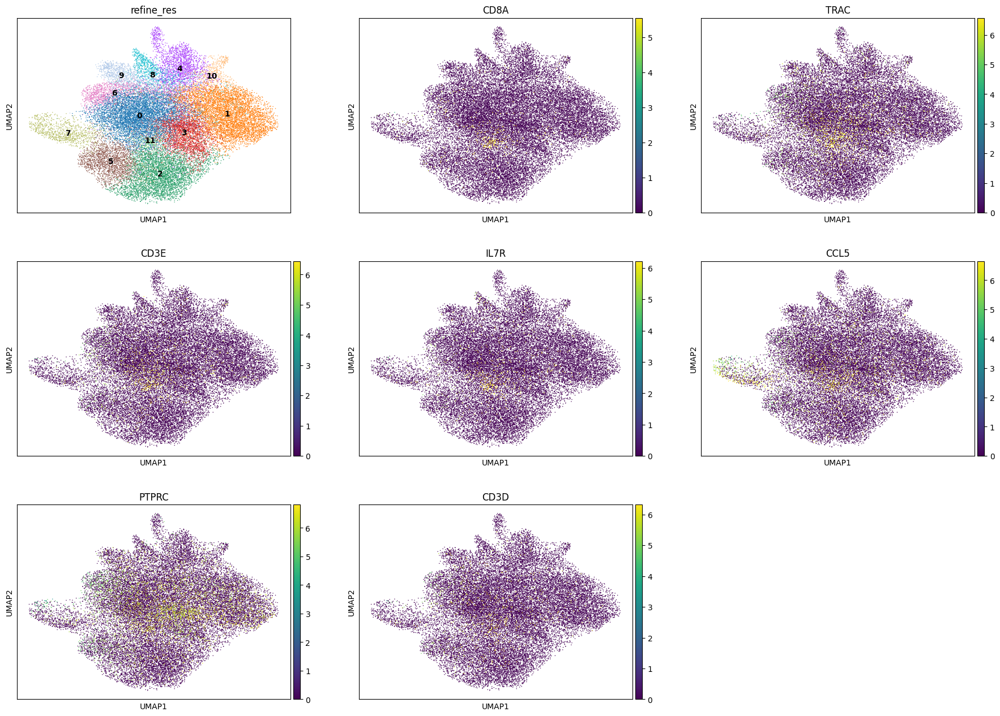

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 303
Percentage of cells in cluster 11: 1.1


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

## 6. Cancer cells

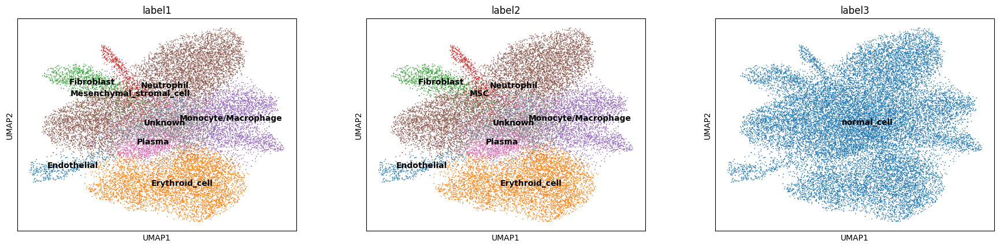

In [105]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

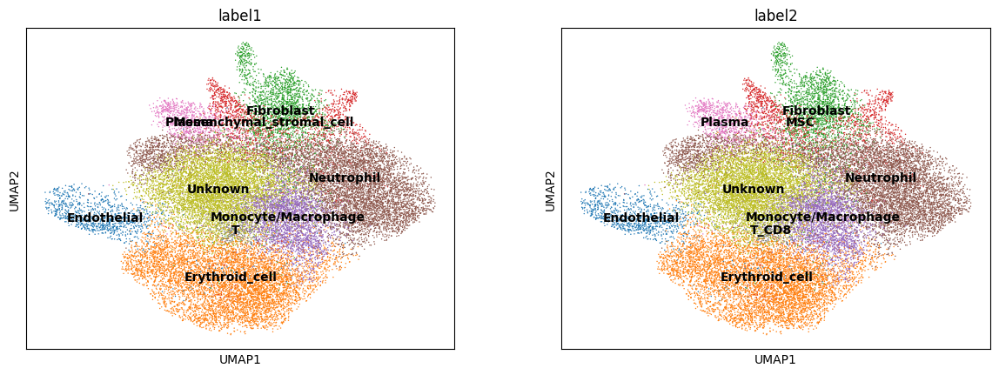

In [7]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [8]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

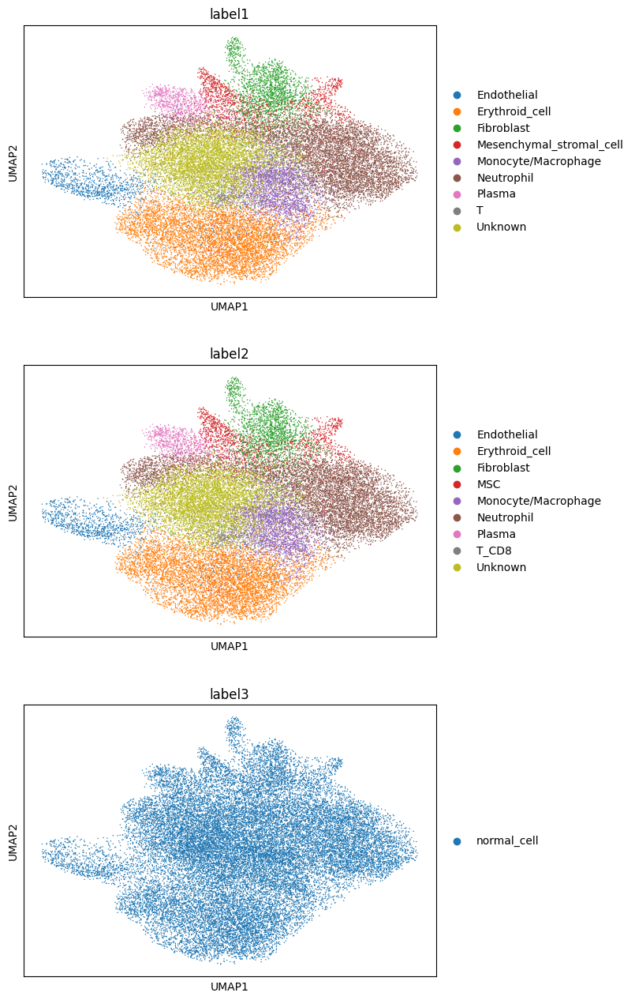

In [9]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [10]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,21,0,0,0,0,21,152.537818,25.739063,cell_labels,1,1,2,2,Erythroid_cell,Erythroid_cell,normal_cell
1,aaaaaaab-1,20,0,0,0,0,20,136.687974,24.384376,cell_labels,1,1,5,5,Erythroid_cell,Erythroid_cell,normal_cell
2,aaaaaaac-1,12,0,0,0,0,12,34.409064,11.018125,cell_labels,0,4,3,3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
4,aaaaaaae-1,35,0,0,0,0,35,101.195160,32.693126,cell_labels,1,1,2,2,Erythroid_cell,Erythroid_cell,normal_cell
5,aaaaaaaf-1,29,0,0,0,0,29,89.770628,26.958282,cell_labels,1,1,5,5,Erythroid_cell,Erythroid_cell,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
84512,aaabekca-1,13,0,0,0,0,13,103.227191,6.908907,cell_labels,1,1,2,2,Erythroid_cell,Erythroid_cell,normal_cell
84513,aaabekcb-1,30,0,0,0,0,30,97.221410,16.482032,cell_labels,0,0,10,10,Mesenchymal_stromal_cell,MSC,normal_cell
84515,aaabekcd-1,41,0,0,0,0,41,196.610320,31.970626,cell_labels,0,2,1,1,Neutrophil,Neutrophil,normal_cell
84516,aaabekce-1,19,0,0,0,0,19,265.292978,17.972188,cell_labels,0,0,0,0,Unknown,Unknown,normal_cell


In [11]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")